<a href="https://colab.research.google.com/github/BassemLakret/blakret.github.io/blob/main/Project__MISE1_GroupE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

PARTIE 1 : Preprocessing






Les résultats obtenus et images sont sur le document Word

In [ ]:
pip install opencv-python-headless

In [ ]:
pip install scikit-learn

In [ ]:
import pandas as pd
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

In [ ]:
image = cv2.imread("/content/sample_data/Project/Background.JPG")
def display_image(image):
  cv2_imshow(image)
  cv2.waitKey(0)

In [ ]:
import os

def resize_images(input_folder, output_folder, target_size):
    # Create the output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Iterate over images in the input folder
    for filename in os.listdir(input_folder):
        img_path = os.path.join(input_folder, filename)

        # Read the image
        img = cv2.imread(img_path)

        if img is not None:
            # Resize the image
            resized_img = cv2.resize(img, target_size)

            # Save the resized image to the output folder
            output_path = os.path.join(output_folder, filename)
            cv2.imwrite(output_path, resized_img)
            print(f"Resized and saved: {output_path}")

# Define input and output folders
input_folder = "/content/sample_data/Project"
output_folder = "/content/sample_data/Resized_Images"

# Define the target size for resizing
target_size = (1024, 768)  # Change as needed

# Resize images
resize_images(input_folder, output_folder, target_size)


Resized and saved: /content/sample_data/Resized_Images/GOPR009.JPG
Resized and saved: /content/sample_data/Resized_Images/GOPR001.JPG
Resized and saved: /content/sample_data/Resized_Images/Background.JPG
Resized and saved: /content/sample_data/Resized_Images/GOPR002.JPG
Resized and saved: /content/sample_data/Resized_Images/GOPR004.JPG
Resized and saved: /content/sample_data/Resized_Images/GOPR008.JPG
Resized and saved: /content/sample_data/Resized_Images/GOPR006.JPG
Resized and saved: /content/sample_data/Resized_Images/GOPR005.JPG
Resized and saved: /content/sample_data/Resized_Images/GOPR010.JPG
Resized and saved: /content/sample_data/Resized_Images/GOPR007.JPG
Resized and saved: /content/sample_data/Resized_Images/GOPR003.JPG


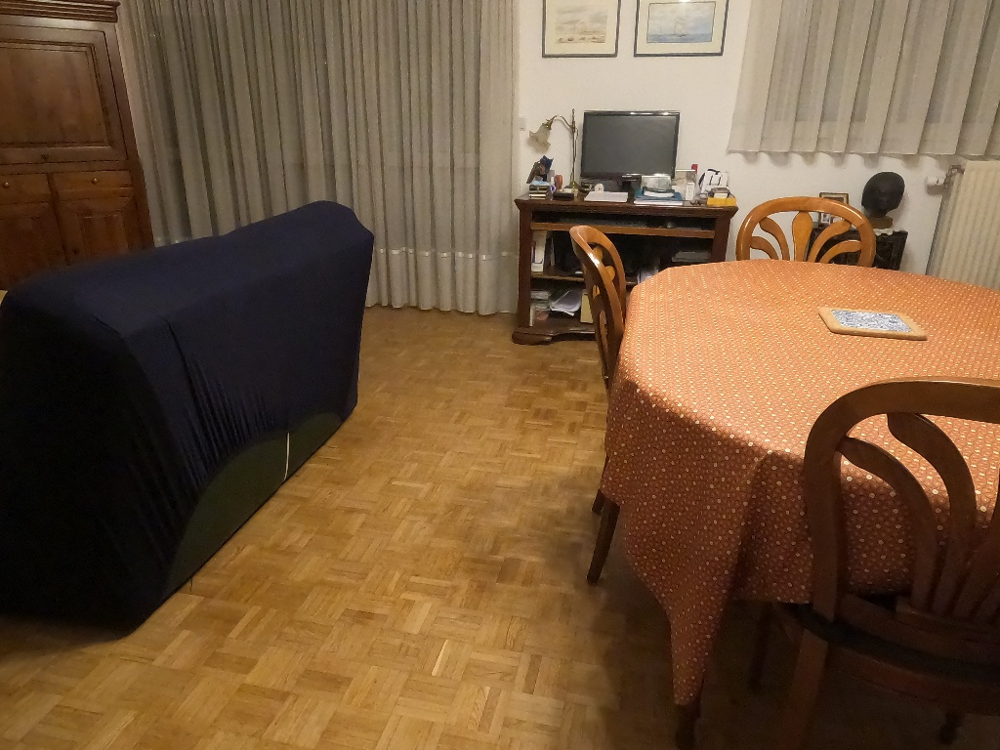

In [ ]:
img_back = cv2.imread("/content/sample_data/Resized_Images/Background.JPG")
display_image(img_back)

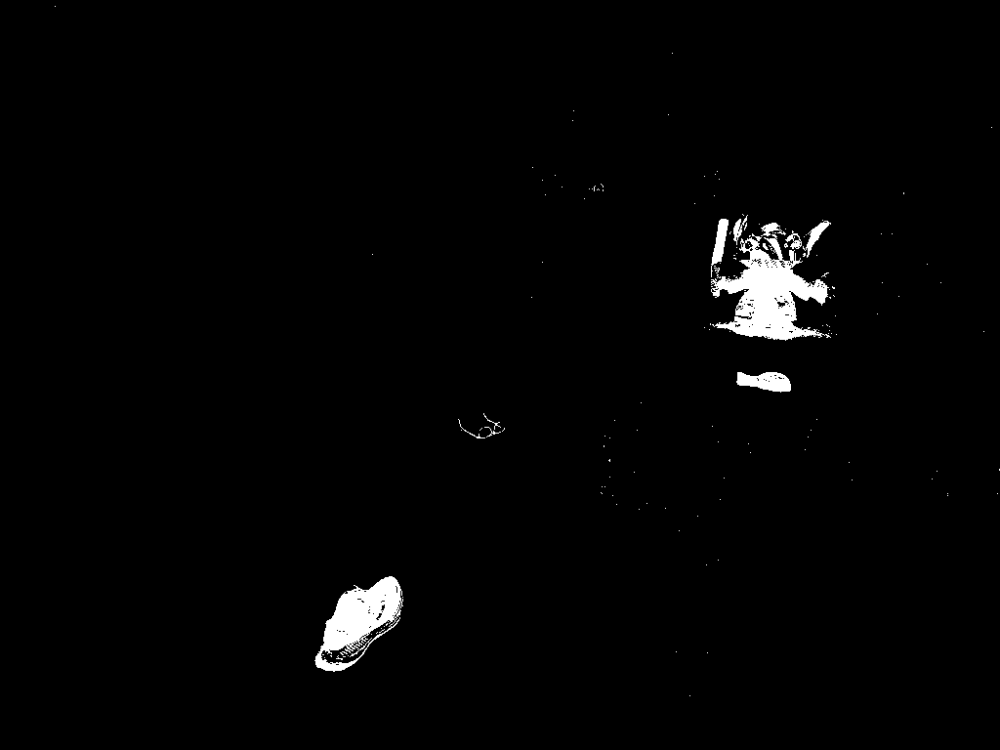

In [ ]:
import cv2 as cv
# Load background and foreground images
background = cv.imread('/content/sample_data/Resized_Images/Background.JPG')
foreground = cv.imread('/content/sample_data/Resized_Images/GOPR001.JPG')

# Convert images to grayscale
background_gray = cv.cvtColor(background, cv.COLOR_BGR2GRAY)
foreground_gray = cv.cvtColor(foreground, cv.COLOR_BGR2GRAY)

# Compute absolute difference between background and foreground
fgmask = cv.absdiff(background_gray, foreground_gray)

# Threshold the absolute difference image
_, fgmask = cv.threshold(fgmask, 50, 255, cv.THRESH_BINARY)

# Display the foreground mask
display_image(fgmask)

Working on the brightness of the images GOPRO02 & GOPRO03

first, GOPRO02

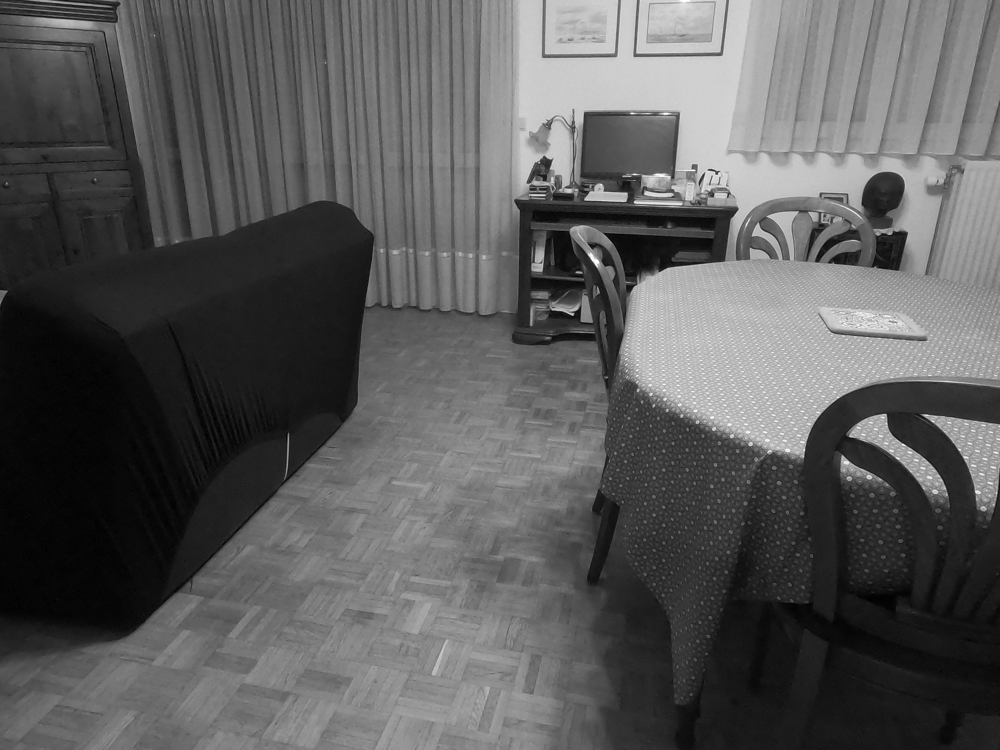

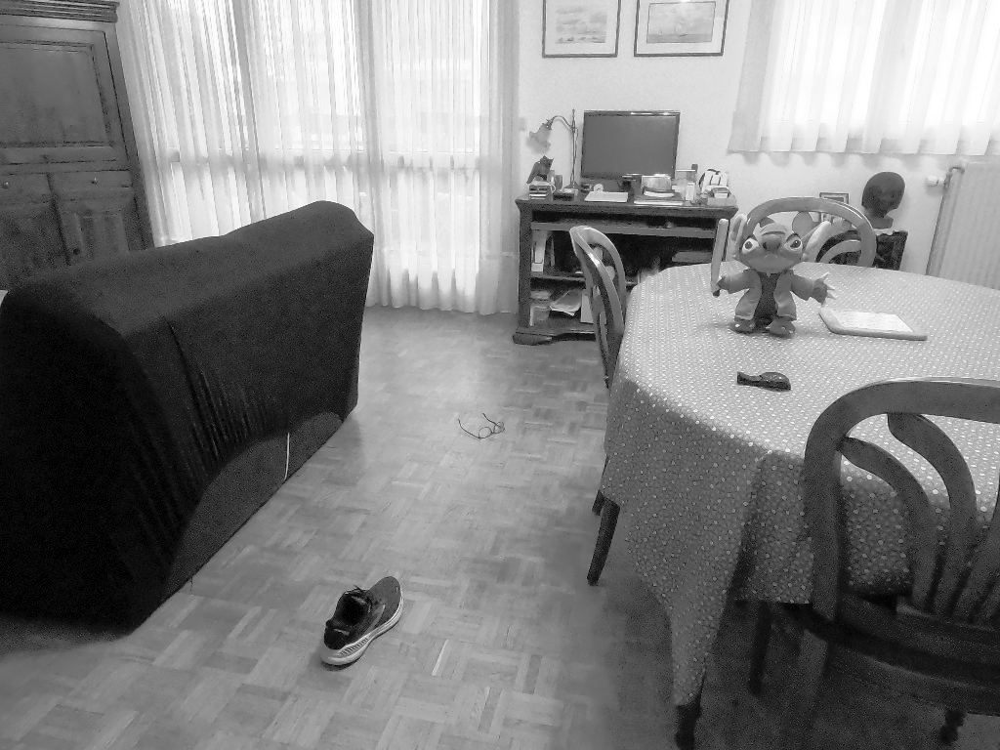

In [ ]:
# Load the altered image
altered_image = cv2.imread('/content/sample_data/Resized_Images/GOPR002.JPG')

# Convert the altered image to grayscale
altered_gray = cv2.cvtColor(altered_image, cv2.COLOR_BGR2GRAY)
image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply histogram equalization
equalized_image = cv2.equalizeHist(altered_gray)

# Save or display the equalized image
display_image(image_gray)
display_image(equalized_image)

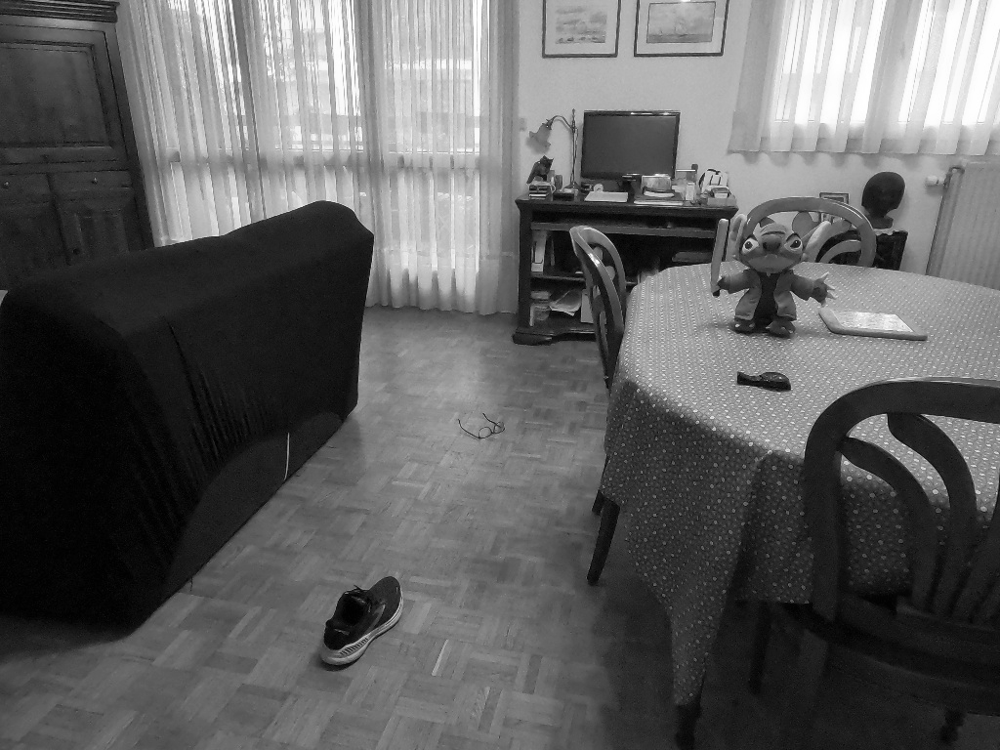

True

In [ ]:
# Load the reference image
reference_image = cv2.imread('/content/sample_data/Resized_Images/Background.JPG')

# Convert the reference image to grayscale
reference_gray = cv2.cvtColor(reference_image, cv2.COLOR_BGR2GRAY)

# Load the altered image
altered_image = cv2.imread('/content/sample_data/Resized_Images/GOPR002.JPG')

# Convert the altered image to grayscale
altered_gray = cv2.cvtColor(altered_image, cv2.COLOR_BGR2GRAY)

# Match histograms of the altered image to the reference image
matched_image = cv2.createCLAHE(clipLimit=0.3, tileGridSize=(8,8)).apply(altered_gray)

# Save or display the matched image
display_image(matched_image)
cv.imwrite('matched_image.jpg', matched_image)

In [ ]:
def calculate_luminosity_difference(reference_image, matched_image):
    # Convert images to grayscale
    reference_gray = cv2.cvtColor(reference_image, cv2.COLOR_BGR2GRAY)
    matched_gray = cv2.cvtColor(matched_image, cv2.COLOR_BGR2GRAY)
    # Calculate the average pixel intensity values
    avg_intensity_ref = np.mean(reference_gray)
    avg_intensity_matched = np.mean(matched_gray)

    # Calculate the absolute difference in average pixel intensities
    abs_diff = abs(avg_intensity_ref - avg_intensity_matched)

    # Calculate the percentage difference
    percentage_diff = (abs_diff / avg_intensity_ref) * 100

    return percentage_diff

# Load the reference and matched images
reference_image = cv2.imread('/content/sample_data/Resized_Images/Background.JPG')
matched_image = cv2.imread('matched_image.jpg')

# Calculate the percentage difference in luminosity
percentage_difference = calculate_luminosity_difference(reference_image, matched_image)
print("Percentage difference in luminosity:", percentage_difference)

Percentage difference in luminosity: 5.5714538163773195


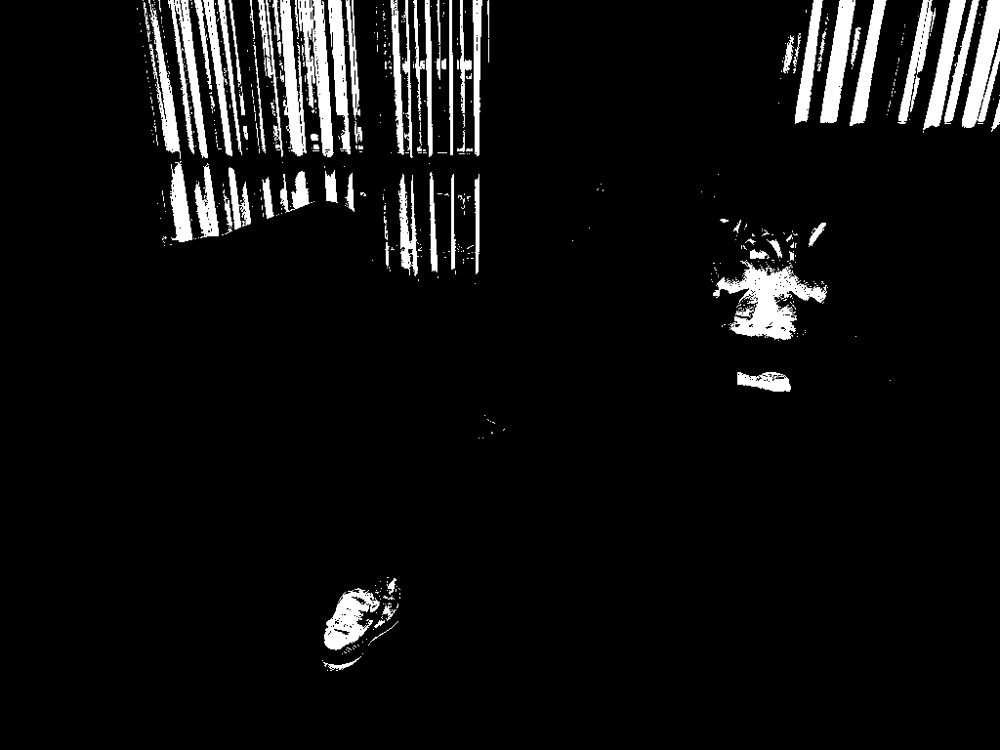

In [ ]:
def find_image_difference(reference_image, matched_image):
    # Convert images to grayscale
    reference_gray = cv2.cvtColor(reference_image, cv2.COLOR_BGR2GRAY)
    matched_gray = cv2.cvtColor(matched_image, cv2.COLOR_BGR2GRAY)

    # Compute absolute difference between the images
    difference = cv2.absdiff(reference_gray, matched_gray)

    # Apply a threshold to highlight the differences
    _, thresholded = cv2.threshold(difference, 96, 255, cv2.THRESH_BINARY)

    return thresholded

# Load the reference and matched images
reference_image = cv2.imread('/content/sample_data/Resized_Images/Background.JPG')
matched_image = cv2.imread('matched_image.jpg')

# Find the difference between the images
difference_mask = find_image_difference(reference_image, matched_image)

# Display the difference mask
display_image(difference_mask)

GOPRO03 SAME AS BEFORE

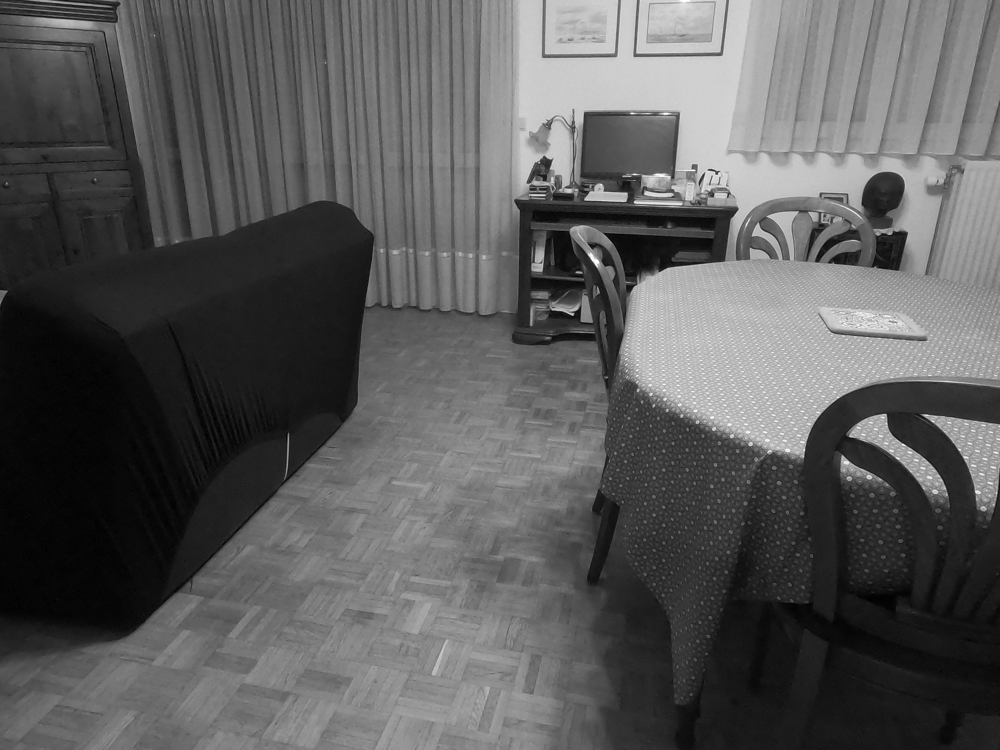

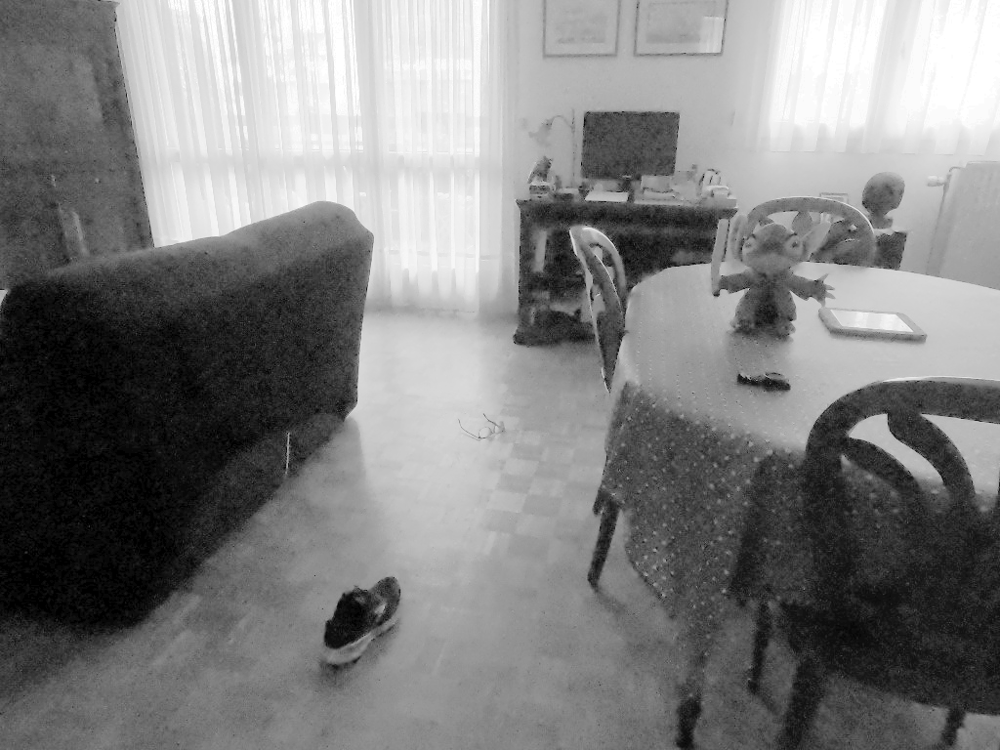

In [ ]:
# Load the altered image
altered_image = cv2.imread('/content/sample_data/Resized_Images/GOPR003.JPG')

# Convert the altered image to grayscale
altered_gray = cv2.cvtColor(altered_image, cv2.COLOR_BGR2GRAY)
image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply histogram equalization
equalized_image = cv2.equalizeHist(altered_gray)

# Save or display the equalized image
display_image(image_gray)
display_image(equalized_image)

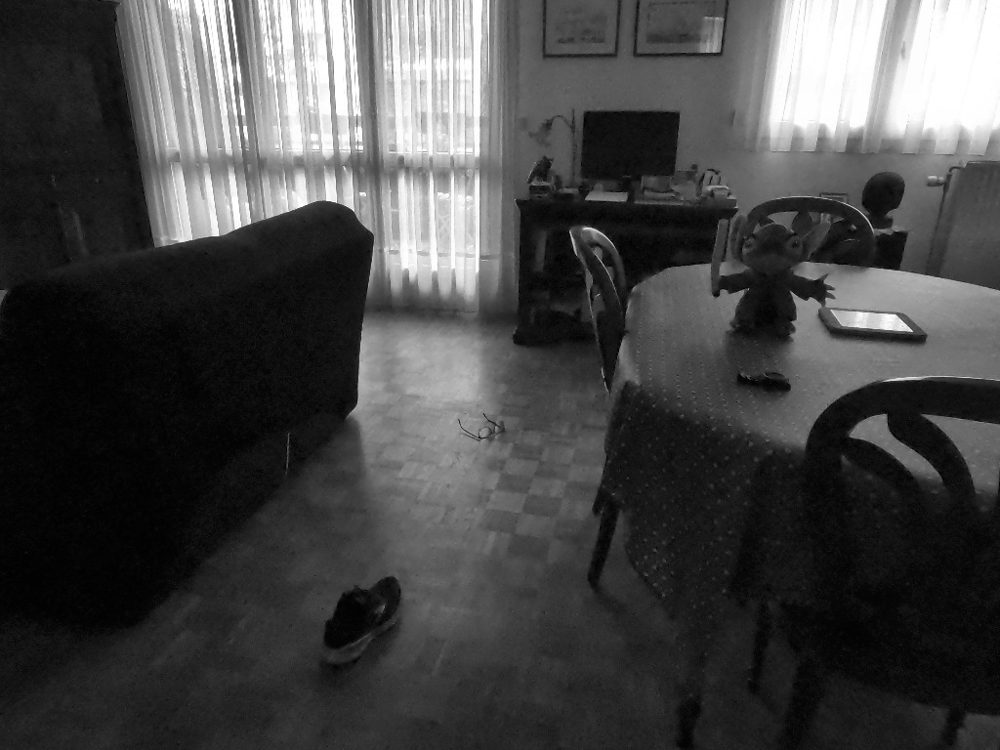

True

In [ ]:
# Load the reference image
reference_image = cv2.imread('/content/sample_data/Resized_Images/Background.JPG')

# Convert the reference image to grayscale
reference_gray = cv2.cvtColor(reference_image, cv2.COLOR_BGR2GRAY)

# Load the altered image
altered_image = cv2.imread('/content/sample_data/Resized_Images/GOPR003.JPG')

# Convert the altered image to grayscale
altered_gray = cv2.cvtColor(altered_image, cv2.COLOR_BGR2GRAY)

# Match histograms of the altered image to the reference image
matched_image_2 = cv2.createCLAHE(clipLimit=0.9, tileGridSize=(8,8)).apply(altered_gray)

# Save or display the matched image
display_image(matched_image_2)
cv2.imwrite("matched_image_2.jpg",matched_image_2)

In [ ]:
def calculate_luminosity_difference(reference_image, matched_image):
    # Convert images to grayscale
    reference_gray = cv2.cvtColor(reference_image, cv2.COLOR_BGR2GRAY)
    matched_gray = cv2.cvtColor(matched_image, cv2.COLOR_BGR2GRAY)

    # Calculate the average pixel intensity values
    avg_intensity_ref = np.mean(reference_gray)
    avg_intensity_matched = np.mean(matched_gray)

    # Calculate the absolute difference in average pixel intensities
    abs_diff = abs(avg_intensity_ref - avg_intensity_matched)

    # Calculate the percentage difference
    percentage_diff = (abs_diff / avg_intensity_ref) * 100

    return percentage_diff

# Load the reference and matched images
reference_image = cv2.imread('/content/sample_data/Resized_Images/Background.JPG')
matched_image = cv2.imread('/content/matched_image_2.jpg')

# Calculate the percentage difference in luminosity
percentage_difference = calculate_luminosity_difference(reference_image, matched_image)
print("Percentage difference in luminosity:", percentage_difference)

Percentage difference in luminosity: 21.284099793166046


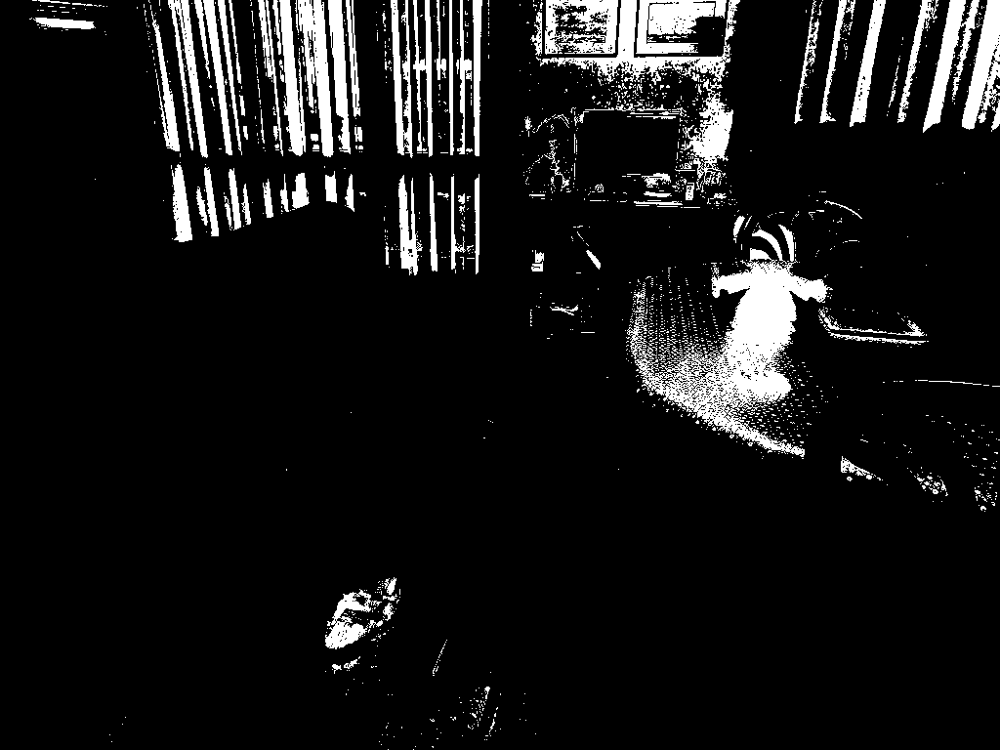

In [ ]:
def find_image_difference(reference_image, matched_image):
    # Convert images to grayscale
    reference_gray = cv2.cvtColor(reference_image, cv2.COLOR_BGR2GRAY)
    matched_gray = cv2.cvtColor(matched_image, cv2.COLOR_BGR2GRAY)

    # Compute absolute difference between the images
    difference = cv2.absdiff(reference_gray, matched_gray)

    # Apply a threshold to highlight the differences
    _, thresholded = cv2.threshold(difference, 115, 255, cv2.THRESH_BINARY)

    return thresholded

# Load the reference and matched images
reference_image = cv2.imread('/content/sample_data/Resized_Images/Background.JPG')
matched_image = cv2.imread('/content/matched_image_2.jpg')

# Find the difference between the images
difference_mask = find_image_difference(reference_image, matched_image)

# Display the difference mask
display_image(difference_mask)

Starting from here, we deal with noise

GOPRO04

Pourcentage de bruit : 2.424367268880208


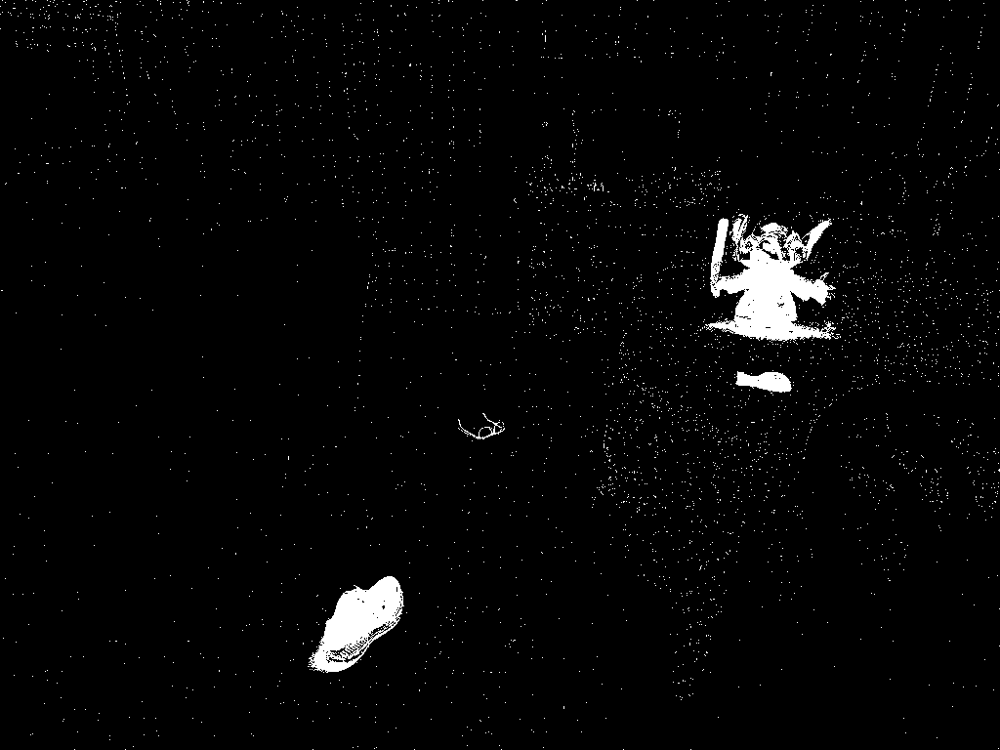

In [ ]:
# Noise detection for image GOPR004
def detect_noise(original_image, noisy_image):
    # Convertir les images en niveaux de gris
    original_gray = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
    noisy_gray = cv2.cvtColor(noisy_image, cv2.COLOR_BGR2GRAY)

    # Calculer la différence absolue entre les images
    diff = cv2.absdiff(original_gray, noisy_gray)

    # Seuil pour détecter les variations de pixel
    threshold = 30

    # Seuiller l'image de différence pour obtenir les pixels de bruit
    _, mask = cv2.threshold(diff, threshold, 255, cv2.THRESH_BINARY)

    # Compter le nombre de pixels de bruit
    num_noise_pixels = np.sum(mask > 0)

    # Calculer le pourcentage de bruit par rapport au nombre total de pixels
    total_pixels = mask.shape[0] * mask.shape[1]
    noise_percentage = (num_noise_pixels / total_pixels) * 100

    return noise_percentage, mask

# Charger l'image originale et l'image bruitée
original_image = cv2.imread("/content/sample_data/Resized_Images/Background.JPG")
noisy_image = cv2.imread("/content/sample_data/Resized_Images/GOPR004.JPG")

# Détecter le bruit
noise_percentage, noise_mask = detect_noise(original_image, noisy_image)

# Afficher le pourcentage de bruit détecté
print("Pourcentage de bruit :", noise_percentage)

# Afficher l'image de masque de bruit
display_image(noise_mask)

Pourcentage de bruit : 20.848464965820312


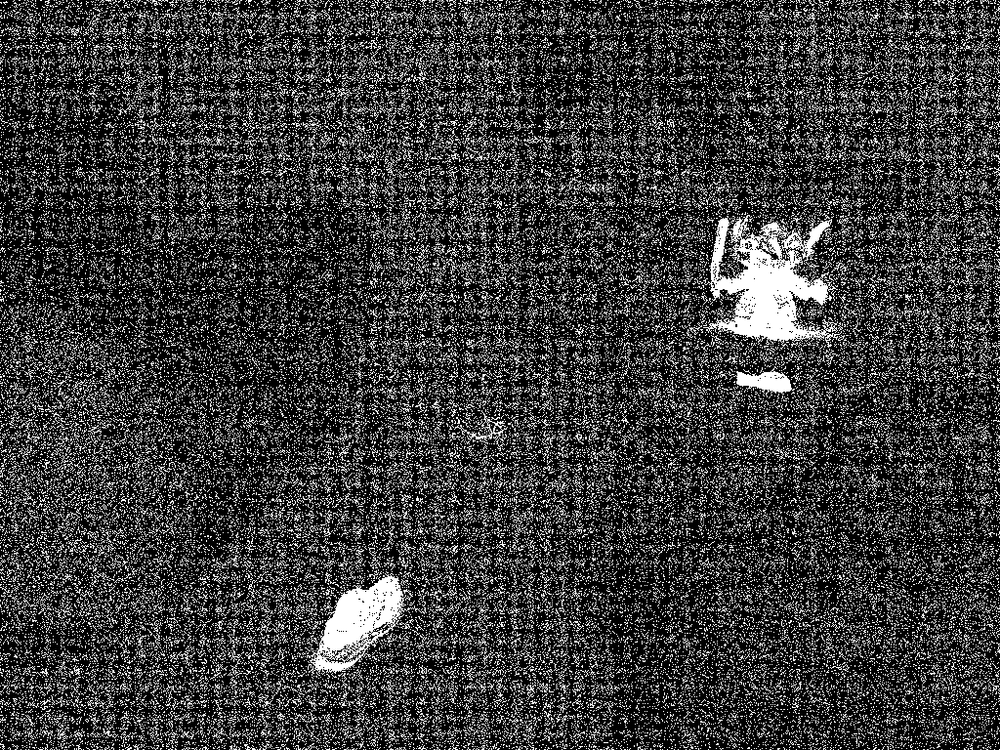

In [ ]:
# Noise detection for image GOPR005
def detect_noise(original_image, noisy_image):
    # Convertir les images en niveaux de gris
    original_gray = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
    noisy_gray = cv2.cvtColor(noisy_image, cv2.COLOR_BGR2GRAY)

    # Calculer la différence absolue entre les images
    diff = cv2.absdiff(original_gray, noisy_gray)

    # Seuil pour détecter les variations de pixel
    threshold = 30

    # Seuiller l'image de différence pour obtenir les pixels de bruit
    _, mask = cv2.threshold(diff, threshold, 255, cv2.THRESH_BINARY)

    # Compter le nombre de pixels de bruit
    num_noise_pixels = np.sum(mask > 0)

    # Calculer le pourcentage de bruit par rapport au nombre total de pixels
    total_pixels = mask.shape[0] * mask.shape[1]
    noise_percentage = (num_noise_pixels / total_pixels) * 100

    return noise_percentage, mask

# Charger l'image originale et l'image bruitée
original_image = cv2.imread("/content/sample_data/Resized_Images/Background.JPG")
noisy_image = cv2.imread("/content/sample_data/Resized_Images/GOPR005.JPG")

# Détecter le bruit
noise_percentage, noise_mask = detect_noise(original_image, noisy_image)

# Afficher le pourcentage de bruit détecté
print("Pourcentage de bruit :", noise_percentage)

# Afficher l'image de masque de bruit
display_image(noise_mask)

Pourcentage de bruit : 2.6640574137369795


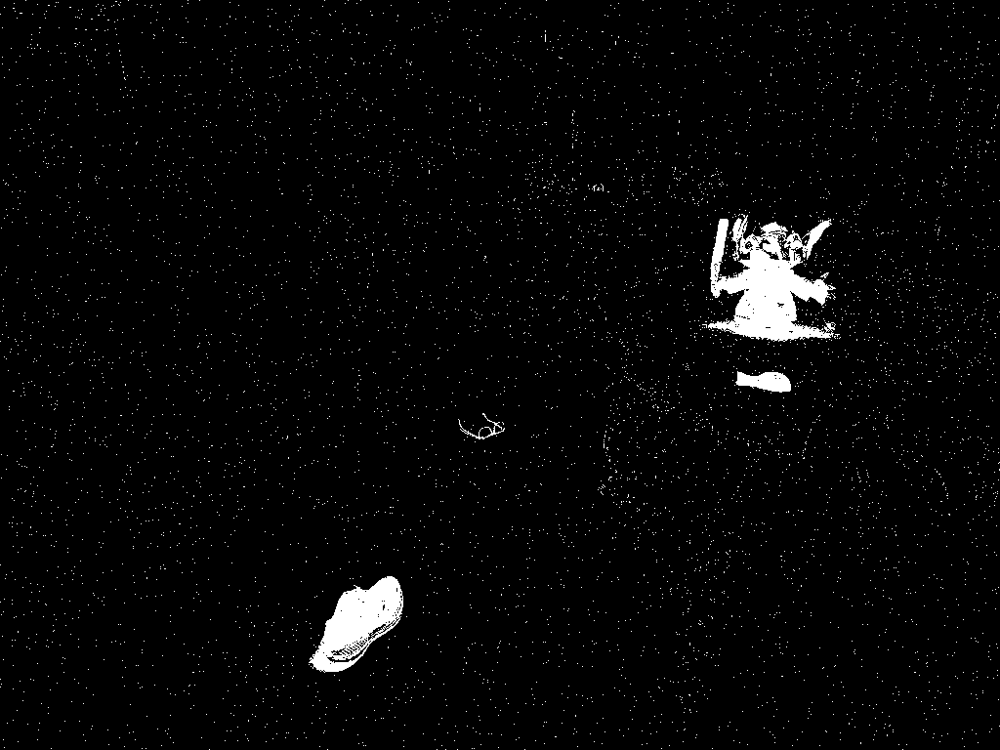

In [ ]:
# Noise detection for image GOPR006
def detect_noise(original_image, noisy_image):
    # Convertir les images en niveaux de gris
    original_gray = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
    noisy_gray = cv2.cvtColor(noisy_image, cv2.COLOR_BGR2GRAY)

    # Calculer la différence absolue entre les images
    diff = cv2.absdiff(original_gray, noisy_gray)

    # Seuil pour détecter les variations de pixel
    threshold = 30

    # Seuiller l'image de différence pour obtenir les pixels de bruit
    _, mask = cv2.threshold(diff, threshold, 255, cv2.THRESH_BINARY)

    # Compter le nombre de pixels de bruit
    num_noise_pixels = np.sum(mask > 0)

    # Calculer le pourcentage de bruit par rapport au nombre total de pixels
    total_pixels = mask.shape[0] * mask.shape[1]
    noise_percentage = (num_noise_pixels / total_pixels) * 100

    return noise_percentage, mask

# Charger l'image originale et l'image bruitée
original_image = cv2.imread("/content/sample_data/Resized_Images/Background.JPG")
noisy_image = cv2.imread("/content/sample_data/Resized_Images/GOPR006.JPG")

# Détecter le bruit
noise_percentage, noise_mask = detect_noise(original_image, noisy_image)

# Afficher le pourcentage de bruit détecté
print("Pourcentage de bruit :", noise_percentage)

# Afficher l'image de masque de bruit
display_image(noise_mask)

Pourcentage de bruit : 7.7526092529296875


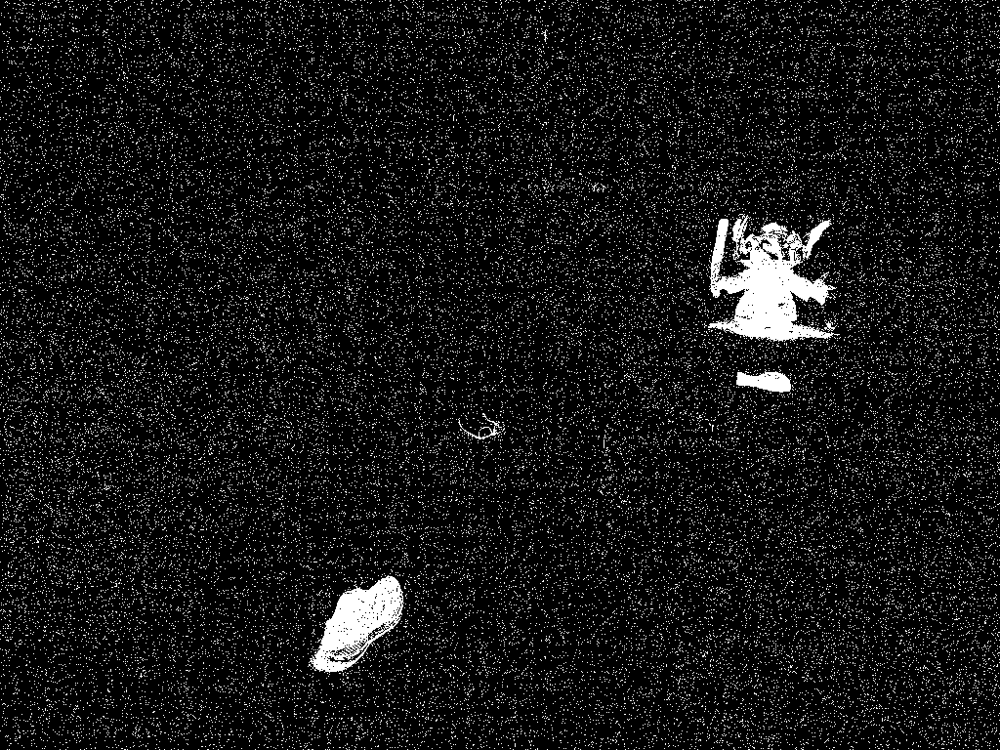

In [ ]:
# Noise detection for image GOPR007
def detect_noise(original_image, noisy_image):
    # Convertir les images en niveaux de gris
    original_gray = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
    noisy_gray = cv2.cvtColor(noisy_image, cv2.COLOR_BGR2GRAY)

    # Calculer la différence absolue entre les images
    diff = cv2.absdiff(original_gray, noisy_gray)

    # Seuil pour détecter les variations de pixel
    threshold = 30

    # Seuiller l'image de différence pour obtenir les pixels de bruit
    _, mask = cv2.threshold(diff, threshold, 255, cv2.THRESH_BINARY)

    # Compter le nombre de pixels de bruit
    num_noise_pixels = np.sum(mask > 0)

    # Calculer le pourcentage de bruit par rapport au nombre total de pixels
    total_pixels = mask.shape[0] * mask.shape[1]
    noise_percentage = (num_noise_pixels / total_pixels) * 100

    return noise_percentage, mask

# Charger l'image originale et l'image bruitée
original_image = cv2.imread("/content/sample_data/Resized_Images/Background.JPG")
noisy_image = cv2.imread("/content/sample_data/Resized_Images/GOPR007.JPG")

# Détecter le bruit
noise_percentage, noise_mask = detect_noise(original_image, noisy_image)

# Afficher le pourcentage de bruit détecté
print("Pourcentage de bruit :", noise_percentage)

# Afficher l'image de masque de bruit
display_image(noise_mask)



In [ ]:
# Mirror Effect detection in GOPR008
def detect_mirror_effect(reference_image, compared_image):
    # Convert images to grayscale
    reference_gray = cv2.cvtColor(reference_image, cv2.COLOR_BGR2GRAY)
    compared_gray = cv2.cvtColor(compared_image, cv2.COLOR_BGR2GRAY)

    # Compute the horizontal mirror of the compared image
    compared_mirror = cv2.flip(compared_gray, 1)

    # Compute absolute difference between reference and mirrored compared image
    diff = cv2.absdiff(reference_gray, compared_mirror)

    # Threshold the difference image
    _, thresholded = cv2.threshold(diff, 30, 255, cv2.THRESH_BINARY)

    # Count non-zero pixels in the thresholded image
    nonzero_pixels = cv2.countNonZero(thresholded)

    # Calculate the percentage of nonzero pixels
    total_pixels = thresholded.shape[0] * thresholded.shape[1]
    mirror_percentage = (nonzero_pixels / total_pixels) * 100

    return mirror_percentage

# Load the reference image and the compared image
reference_image = cv2.imread("/content/sample_data/Resized_Images/Background.JPG")
compared_image = cv2.imread("/content/sample_data/Resized_Images/GOPR008.JPG")

# Detect the mirror effect
mirror_percentage = detect_mirror_effect(reference_image, compared_image)

# Determine if mirror effect is present
if mirror_percentage > 0.1:  # Adjust the threshold as needed
    print("Mirror effect detected! Percentage:", mirror_percentage)
else:
    print("No mirror effect detected.")


Mirror effect detected! Percentage: 71.89966837565103


Mirror effect detected! Percentage: 71.89966837565103


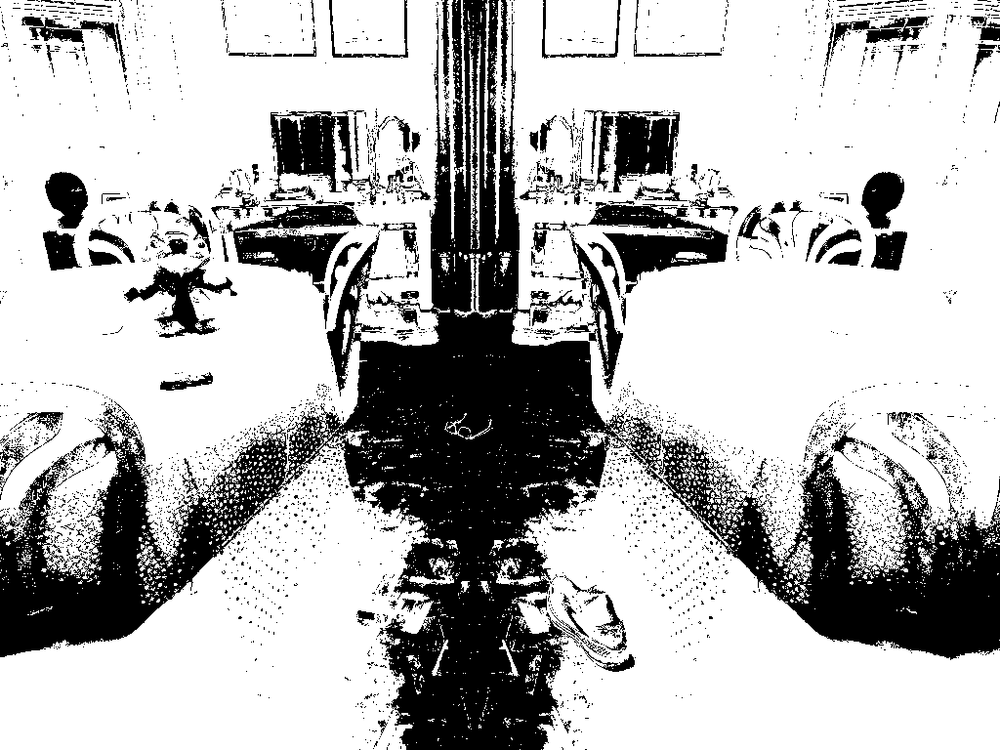

In [ ]:
def detect_mirror_effect(reference_image, compared_image):
    # Convert images to grayscale
    reference_gray = cv2.cvtColor(reference_image, cv2.COLOR_BGR2GRAY)
    compared_gray = cv2.cvtColor(compared_image, cv2.COLOR_BGR2GRAY)

    # Compute the horizontal mirror of the compared image
    compared_mirror = cv2.flip(compared_gray, 1)

    # Compute absolute difference between reference and mirrored compared image
    diff = cv2.absdiff(reference_gray, compared_mirror)

    # Threshold the difference image
    _, thresholded = cv2.threshold(diff, 30, 255, cv2.THRESH_BINARY)

    # Count non-zero pixels in the thresholded image
    nonzero_pixels = cv2.countNonZero(thresholded)

    # Calculate the percentage of nonzero pixels
    total_pixels = thresholded.shape[0] * thresholded.shape[1]
    mirror_percentage = (nonzero_pixels / total_pixels) * 100

    return mirror_percentage, thresholded

# Load the reference image and the compared image
reference_image = cv2.imread("/content/sample_data/Resized_Images/Background.JPG")
compared_image = cv2.imread("/content/sample_data/Resized_Images/GOPR008.JPG")

# Detect the mirror effect
mirror_percentage, thresholded_diff = detect_mirror_effect(reference_image, compared_image)

# Determine if mirror effect is present
if mirror_percentage > 0.1:  # Adjust the threshold as needed
    print("Mirror effect detected! Percentage:", mirror_percentage)
else:
    print("No mirror effect detected. Percentage:", mirror_percentage)

# Display the thresholded difference image
display_image(thresholded_diff)



In [ ]:
# Image rotation for image GOPR009
def detect_rotation(reference_image, compared_image):
    # Convert images to grayscale
    reference_gray = cv2.cvtColor(reference_image, cv2.COLOR_BGR2GRAY)
    compared_gray = cv2.cvtColor(compared_image, cv2.COLOR_BGR2GRAY)

    # Initialize ORB detector
    orb = cv2.ORB_create()

    # Find keypoints and descriptors in both images
    keypoints1, descriptors1 = orb.detectAndCompute(reference_gray, None)
    keypoints2, descriptors2 = orb.detectAndCompute(compared_gray, None)

    # Match keypoints between the images
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(descriptors1, descriptors2)

    # Sort matches by distance
    matches = sorted(matches, key=lambda x: x.distance)

    # Select top matches
    num_matches = 50
    matches = matches[:num_matches]

    # Extract matched keypoints
    src_points = np.float32([keypoints1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
    dst_points = np.float32([keypoints2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)

    # Calculate rotation matrix using RANSAC
    M, _ = cv2.findHomography(src_points, dst_points, cv2.RANSAC)

    # Calculate rotation angle from transformation matrix
    angle_rad = -np.arctan2(M[0, 1], M[0, 0])
    angle_deg = np.degrees(angle_rad)

    return angle_deg

# Load reference image and compared image
reference_image = cv2.imread("/content/sample_data/Resized_Images/GOPR009.JPG")
compared_image = cv2.imread("/content/sample_data/Resized_Images/Background.JPG")

# Detect rotation between images
rotation_angle = detect_rotation(reference_image, compared_image)
print("Rotation angle:", rotation_angle)


Rotation angle: -0.1178311539176425


In [ ]:
# Rotation image GOPR010
reference_image = cv2.imread("/content/sample_data/Resized_Images/GOPR010.JPG")
compared_image = cv2.imread("/content/sample_data/Resized_Images/Background.JPG")

# Detect rotation between images
rotation_angle = detect_rotation(reference_image, compared_image)
print("Rotation angle:", rotation_angle)

Rotation angle: 5.67307597109004


PARTIE 2 : Difference Detection

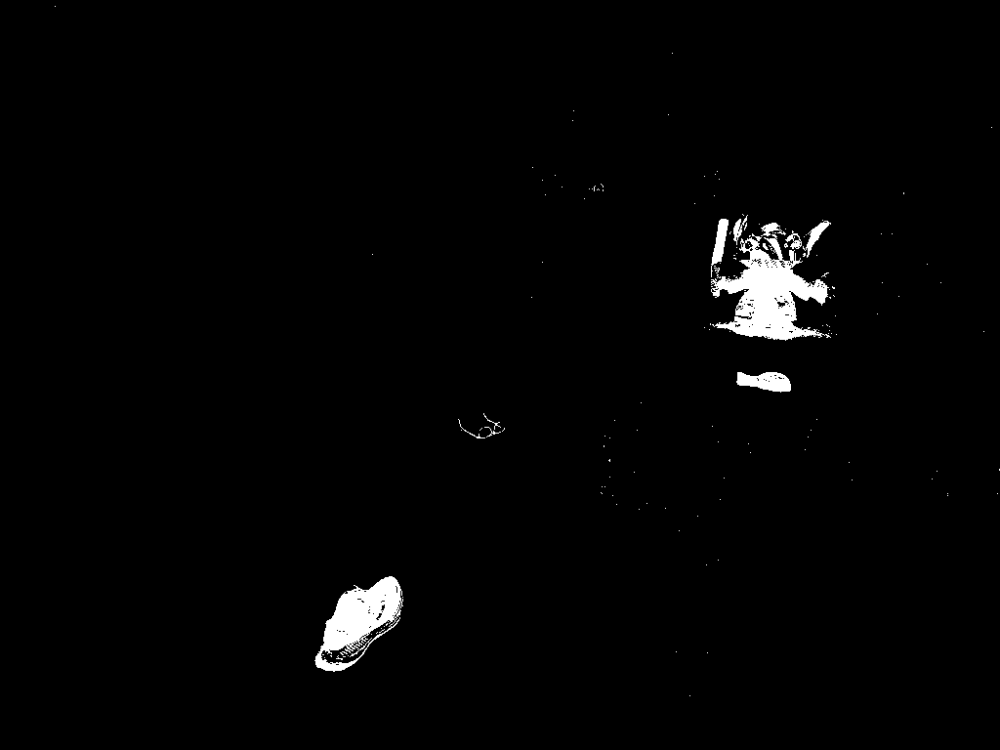

In [ ]:
import cv2 as cv
# Load background and foreground images
background = cv.imread('/content/sample_data/Resized_Images/Background.JPG')
foreground = cv.imread('/content/sample_data/Resized_Images/GOPR001.JPG')

# Convert images to grayscale
background_gray = cv.cvtColor(background, cv.COLOR_BGR2GRAY)
foreground_gray = cv.cvtColor(foreground, cv.COLOR_BGR2GRAY)

# Compute absolute difference between background and foreground
fgmask = cv.absdiff(background_gray, foreground_gray)

# Threshold the absolute difference image
_, fgmask = cv.threshold(fgmask, 50, 255, cv.THRESH_BINARY)

# Display the foreground mask
display_image(fgmask)


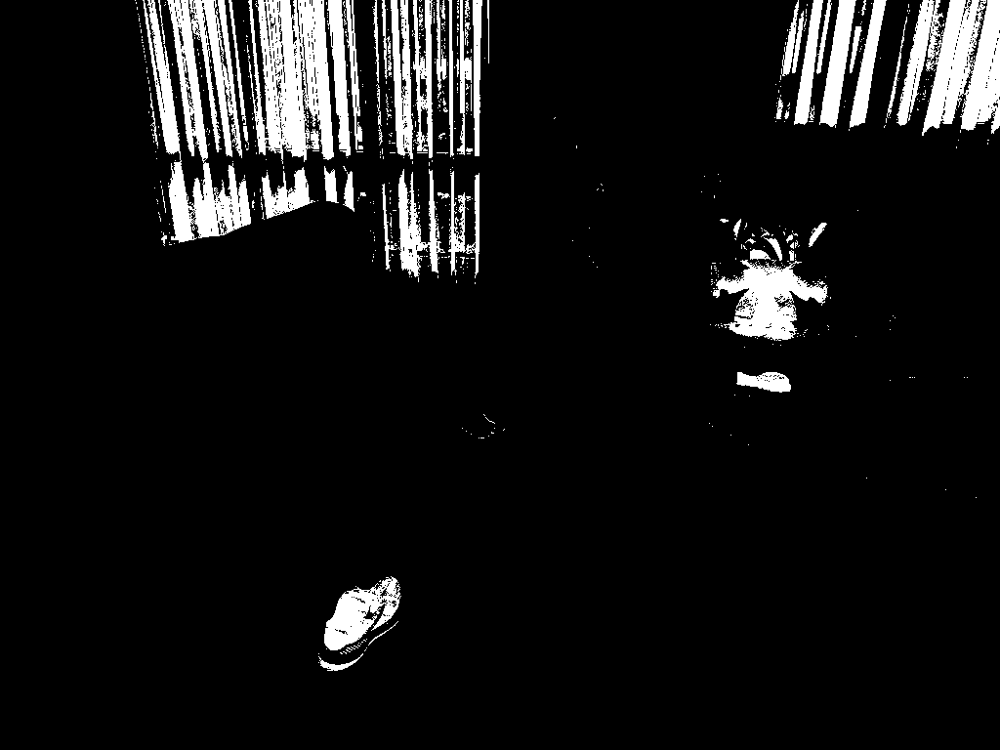

In [ ]:
# Load background and foreground images
background = cv.imread('/content/sample_data/Resized_Images/Background.JPG')
foreground = cv.imread('/content/sample_data/Resized_Images/GOPR002.JPG')

# Convert images to grayscale
background_gray = cv.cvtColor(background, cv.COLOR_BGR2GRAY)
foreground_gray = cv.cvtColor(foreground, cv.COLOR_BGR2GRAY)

background_equalized = cv.equalizeHist(background_gray)
foreground_equalized = cv.equalizeHist(foreground_gray)

# Compute absolute difference between background and foreground
fgmask = cv.absdiff(background_equalized, foreground_equalized)

# Compute absolute difference between background and foreground
fgmask = cv.absdiff(background_gray, foreground_gray)

# Threshold the absolute difference image
_, fgmask = cv.threshold(fgmask, 85, 255, cv.THRESH_BINARY)

# Display the foreground mask
display_image(fgmask)


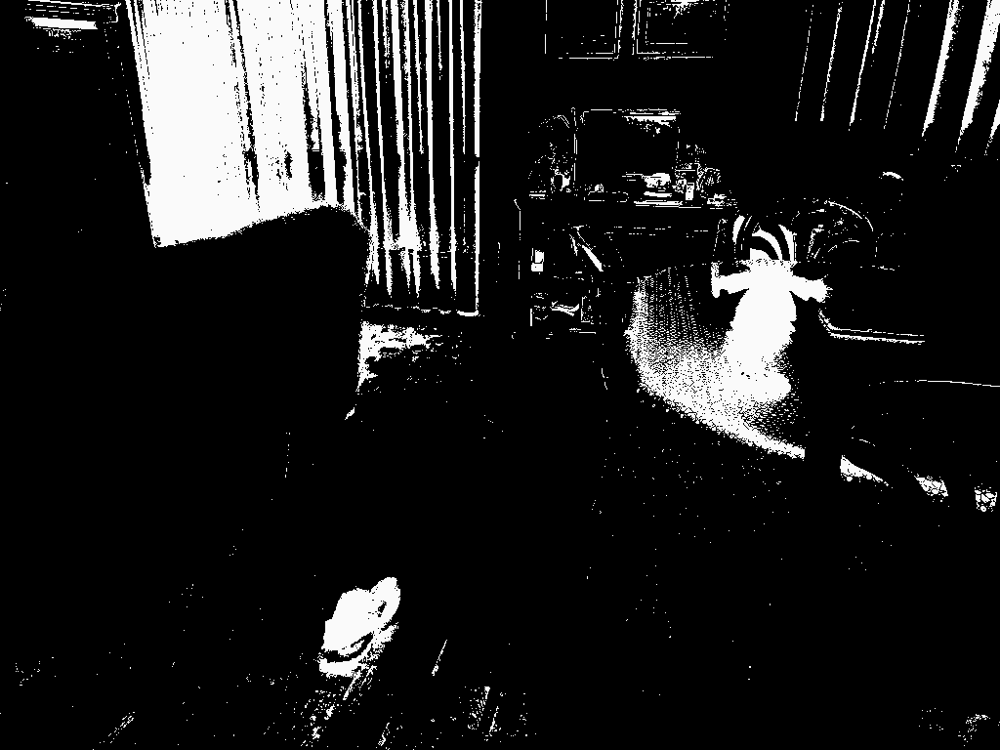

In [ ]:
# Load background and foreground images
background = cv.imread('/content/sample_data/Resized_Images/Background.JPG')
foreground = cv.imread('/content/sample_data/Resized_Images/GOPR003.JPG')

# Convert images to grayscale
background_gray = cv.cvtColor(background, cv.COLOR_BGR2GRAY)
foreground_gray = cv.cvtColor(foreground, cv.COLOR_BGR2GRAY)

background_equalized = cv.equalizeHist(background_gray)
foreground_equalized = cv.equalizeHist(foreground_gray)

# Compute absolute difference between background and foreground
fgmask = cv.absdiff(background_equalized, foreground_equalized)

# Threshold the absolute difference image
_, fgmask = cv.threshold(fgmask, 80, 250, cv.THRESH_BINARY)

# Display the foreground mask
display_image(fgmask)


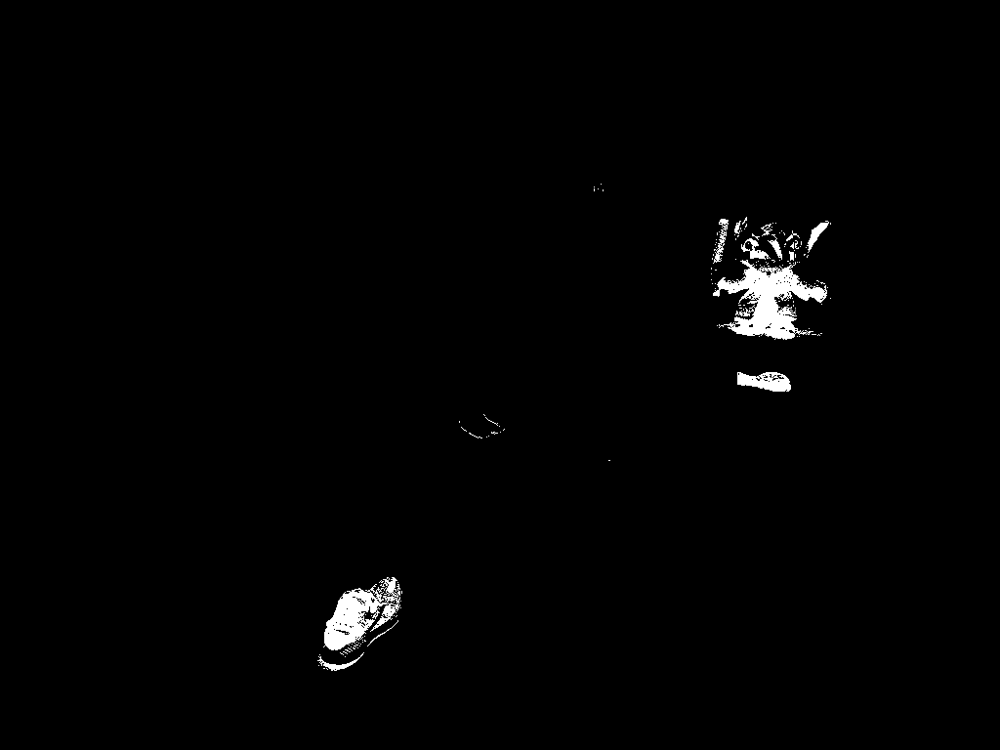

In [ ]:
# Load background and foreground images
background = cv.imread('/content/sample_data/Resized_Images/Background.JPG')
foreground = cv.imread('/content/sample_data/Resized_Images/GOPR004.JPG')

# Convert images to grayscale
background_gray = cv.cvtColor(background, cv.COLOR_BGR2GRAY)
foreground_gray = cv.cvtColor(foreground, cv.COLOR_BGR2GRAY)

# Compute absolute difference between background and foreground
fgmask = cv.absdiff(background_gray, foreground_gray)

# Threshold the absolute difference image
_, fgmask = cv.threshold(fgmask, 80, 255, cv.THRESH_BINARY)
# We can adjust the intensity value assigned to foreground pixels in the resulting binary image,
# we can change the 255 parameter

# Display the foreground mask
display_image(fgmask)


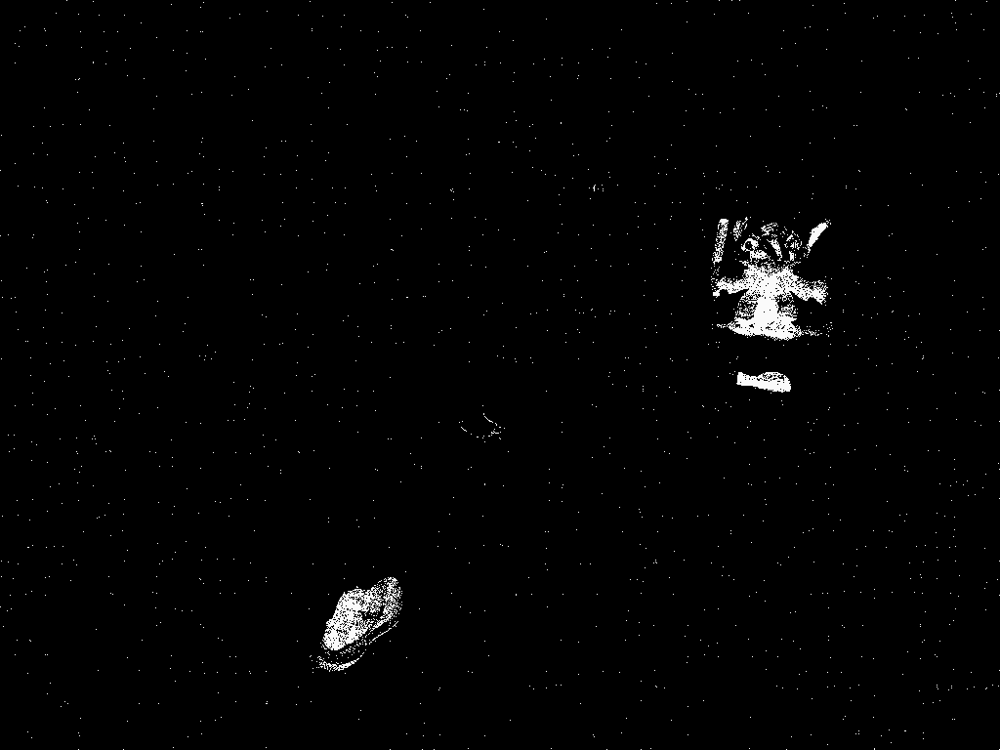

In [ ]:
# Load background and foreground images
background = cv.imread('/content/sample_data/Resized_Images/Background.JPG')
foreground = cv.imread('/content/sample_data/Resized_Images/GOPR005.JPG')

# Convert images to grayscale
background_gray = cv.cvtColor(background, cv.COLOR_BGR2GRAY)
foreground_gray = cv.cvtColor(foreground, cv.COLOR_BGR2GRAY)

# Compute absolute difference between background and foreground
fgmask = cv.absdiff(background_gray, foreground_gray)

# Threshold the absolute difference image
_, fgmask = cv.threshold(fgmask, 80, 250, cv.THRESH_BINARY)

# Display the foreground mask
display_image(fgmask)

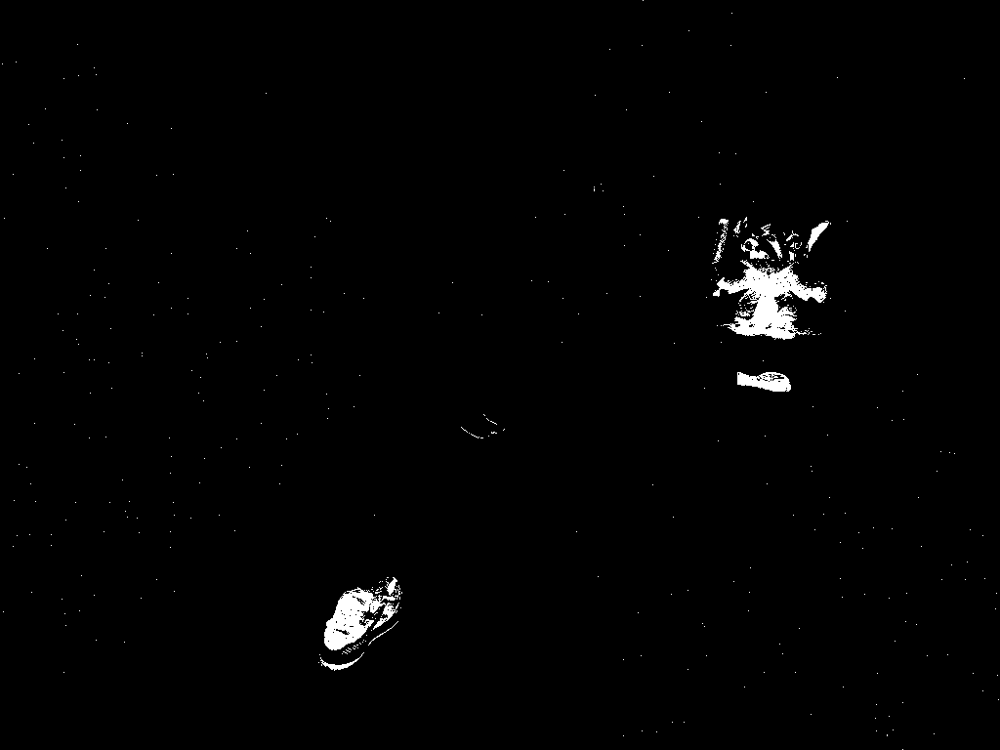

In [ ]:
# Load background and foreground images
background = cv.imread('/content/sample_data/Resized_Images/Background.JPG')
foreground = cv.imread('/content/sample_data/Resized_Images/GOPR006.JPG')

# Convert images to grayscale
background_gray = cv.cvtColor(background, cv.COLOR_BGR2GRAY)
foreground_gray = cv.cvtColor(foreground, cv.COLOR_BGR2GRAY)

# Compute absolute difference between background and foreground
fgmask = cv.absdiff(background_gray, foreground_gray)

# Threshold the absolute difference image
_, fgmask = cv.threshold(fgmask, 85, 255, cv.THRESH_BINARY)

# Display the foreground mask
display_image(fgmask)

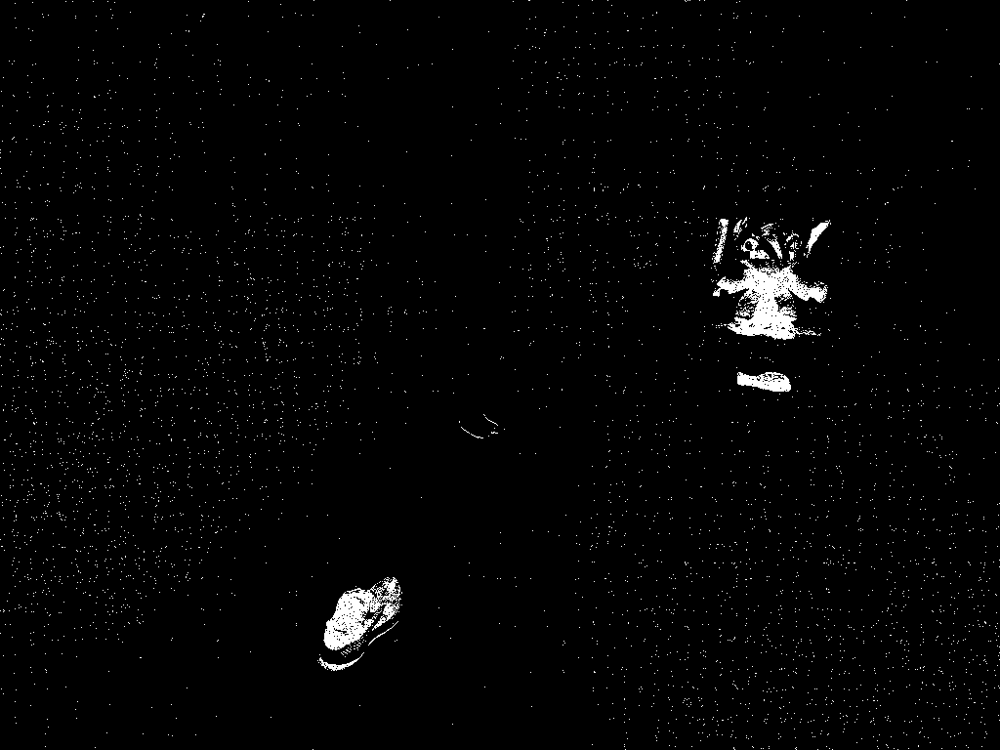

In [ ]:
# Load background and foreground images
background = cv.imread('/content/sample_data/Resized_Images/Background.JPG')
foreground = cv.imread('/content/sample_data/Resized_Images/GOPR007.JPG')

# Convert images to grayscale
background_gray = cv.cvtColor(background, cv.COLOR_BGR2GRAY)
foreground_gray = cv.cvtColor(foreground, cv.COLOR_BGR2GRAY)

# Compute absolute difference between background and foreground
fgmask = cv.absdiff(background_gray, foreground_gray)

# Threshold the absolute difference image
_, fgmask = cv.threshold(fgmask, 80, 255, cv.THRESH_BINARY)

# Display the foreground mask
display_image(fgmask)

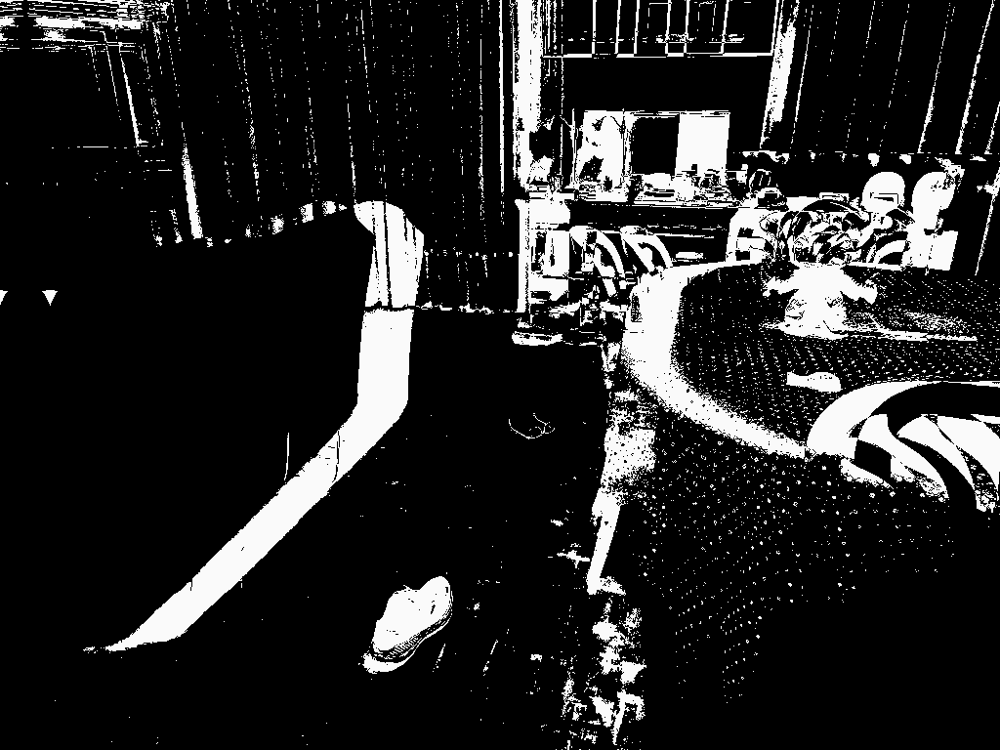

In [ ]:
# Load background and foreground images
background = cv.imread('/content/sample_data/Resized_Images/Background.JPG')
foreground = cv.imread('/content/sample_data/Resized_Images/GOPR008.JPG')

# Convert images to grayscale
background_gray = cv.cvtColor(background, cv.COLOR_BGR2GRAY)
foreground_gray = cv.cvtColor(foreground, cv.COLOR_BGR2GRAY)

# Compute absolute difference between background and foreground
fgmask = cv.absdiff(background_gray, foreground_gray)

# Threshold the absolute difference image
_, fgmask = cv.threshold(fgmask, 50, 250, cv.THRESH_BINARY)

# Display the foreground mask
display_image(fgmask)

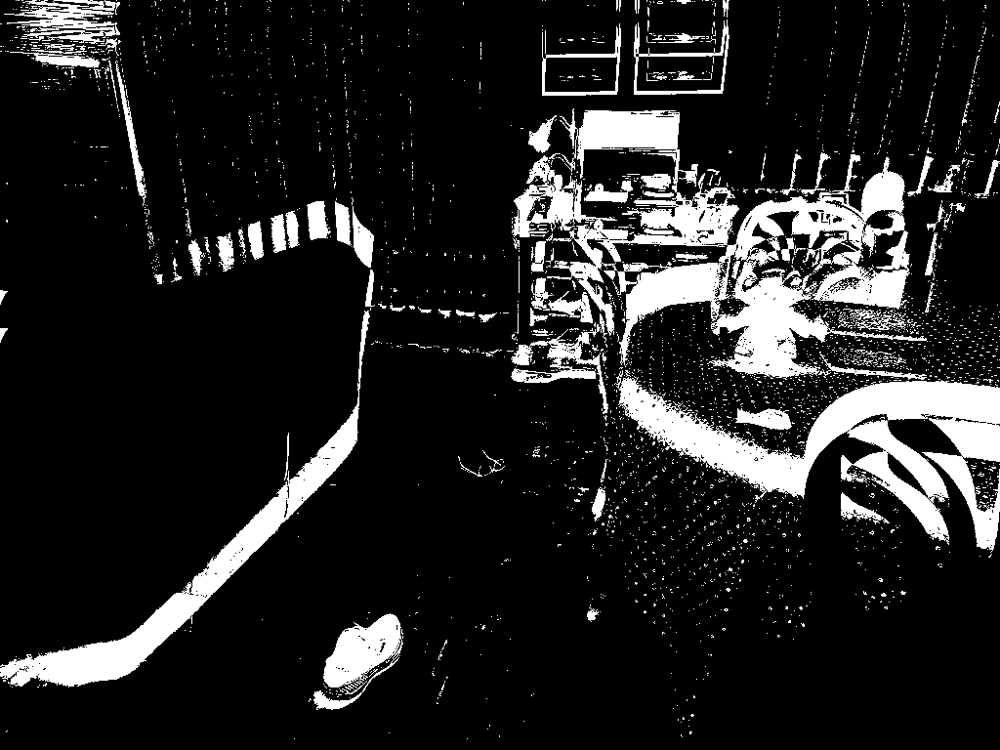

In [ ]:
# Load background and foreground images
background = cv.imread('/content/sample_data/Resized_Images/Background.JPG')
foreground = cv.imread('/content/sample_data/Resized_Images/GOPR009.JPG')

# Convert images to grayscale
background_gray = cv.cvtColor(background, cv.COLOR_BGR2GRAY)
foreground_gray = cv.cvtColor(foreground, cv.COLOR_BGR2GRAY)

# Compute absolute difference between background and foreground
fgmask = cv.absdiff(background_gray, foreground_gray)

# Threshold the absolute difference image
_, fgmask = cv.threshold(fgmask, 50, 255, cv.THRESH_BINARY)

# Display the foreground mask
display_image(fgmask)

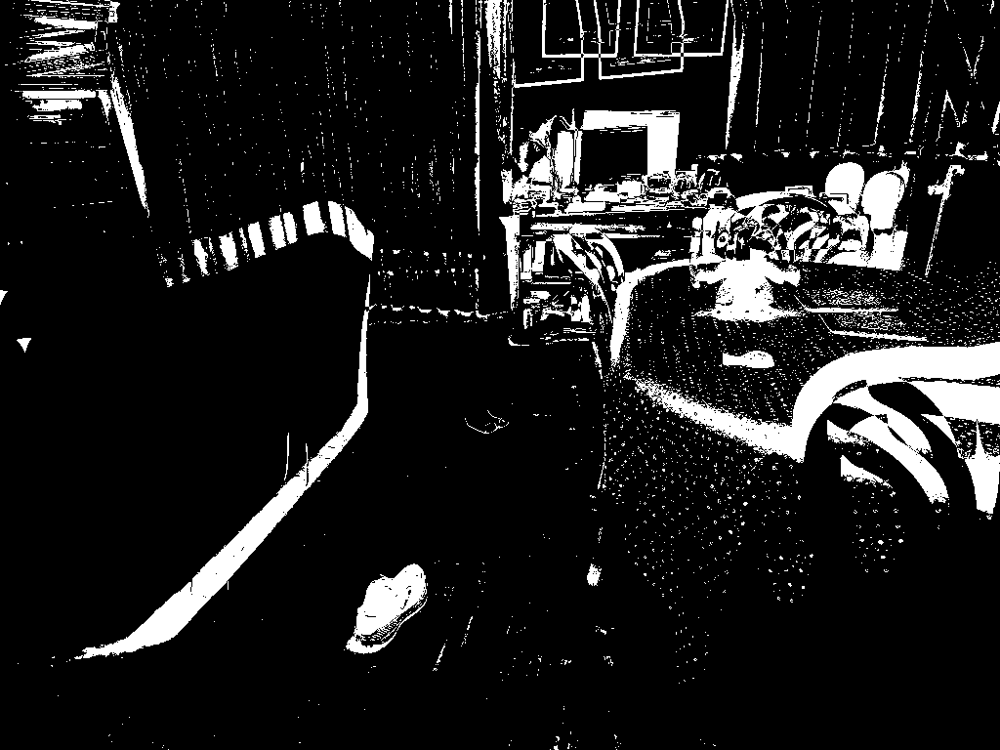

In [ ]:
# Load background and foreground images
background = cv.imread('/content/sample_data/Resized_Images/Background.JPG')
foreground = cv.imread('/content/sample_data/Resized_Images/GOPR010.JPG')

# Convert images to grayscale
background_gray = cv.cvtColor(background, cv.COLOR_BGR2GRAY)
foreground_gray = cv.cvtColor(foreground, cv.COLOR_BGR2GRAY)

# Compute absolute difference between background and foreground
fgmask = cv.absdiff(background_gray, foreground_gray)

# Threshold the absolute difference image
_, fgmask = cv.threshold(fgmask, 50, 255, cv.THRESH_BINARY)

# Display the foreground mask
display_image(fgmask)

PARTIE 3 : Visualization and Analysis of results

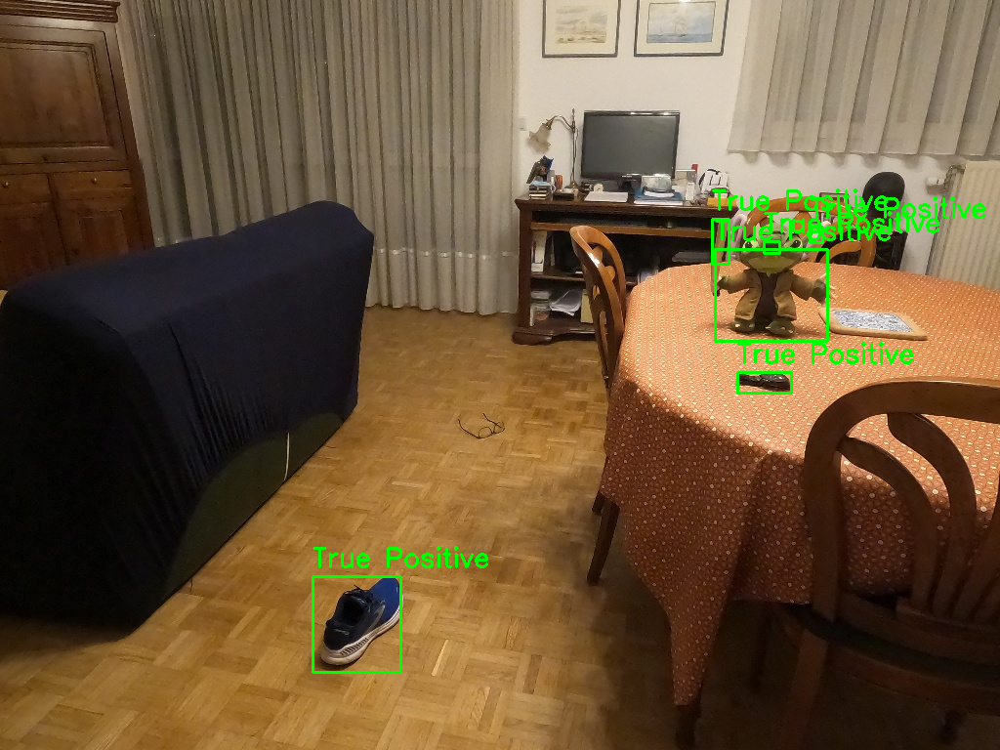

False Positives: 0
False Negatives: 1
True Positives: 6


In [ ]:
import cv2
import numpy as np


# Charger l'image de référence et l'image modifiée
reference_image = cv2.imread('/content/sample_data/Resized_Images/Background.JPG')
gopro02_image = cv2.imread('/content/sample_data/Resized_Images/GOPR001.JPG')

# Convertir les images en niveaux de gris
reference_gray = cv2.cvtColor(reference_image, cv2.COLOR_BGR2GRAY)
gopro02_gray = cv2.cvtColor(gopro02_image, cv2.COLOR_BGR2GRAY)

# Soustraction d'arrière-plan pour détecter les différences
diff = cv2.absdiff(reference_gray, gopro02_gray)

# Seuillage de l'image de différence pour obtenir un masque binaire
threshold = 30  # Ajuster cette valeur selon vos besoins
_, binary_mask = cv2.threshold(diff, threshold, 255, cv2.THRESH_BINARY)

# Suppression des faux positifs à l'aide de transformations morphologiques
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
opening = cv2.morphologyEx(binary_mask, cv2.MORPH_OPEN, kernel, iterations=2)

# Segmentation pour isoler chaque objet
contours, _ = cv2.findContours(opening, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Dessiner un rectangle autour de chaque objet détecté
objects_with_boxes = gopro02_image.copy()
false_positives = 0
true_positives = 0
false_negatives = 0

for contour in contours:
    if cv2.contourArea(contour) > 100:  # Ajuster cette valeur selon vos besoins
        x, y, w, h = cv2.boundingRect(contour)
        cv2.rectangle(objects_with_boxes, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # Vérifier s'il y a chevauchement avec l'image de référence
        if np.any(diff[y:y + h, x:x + w] != 0):
            cv2.putText(objects_with_boxes, 'True Positive', (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)
            true_positives += 1
        else:
            cv2.putText(objects_with_boxes, 'False Positive', (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 0, 255), 2)
            false_positives += 1
    else:
        false_negatives += 1

# Afficher l'image modifiée avec les objets détectés et les rectangles de délimitation
display_image(objects_with_boxes)
cv2.waitKey(0)
cv2.destroyAllWindows()

# Afficher les résultats
print("False Positives:", false_positives)
print("False Negatives:", false_negatives)
print("True Positives:", true_positives)

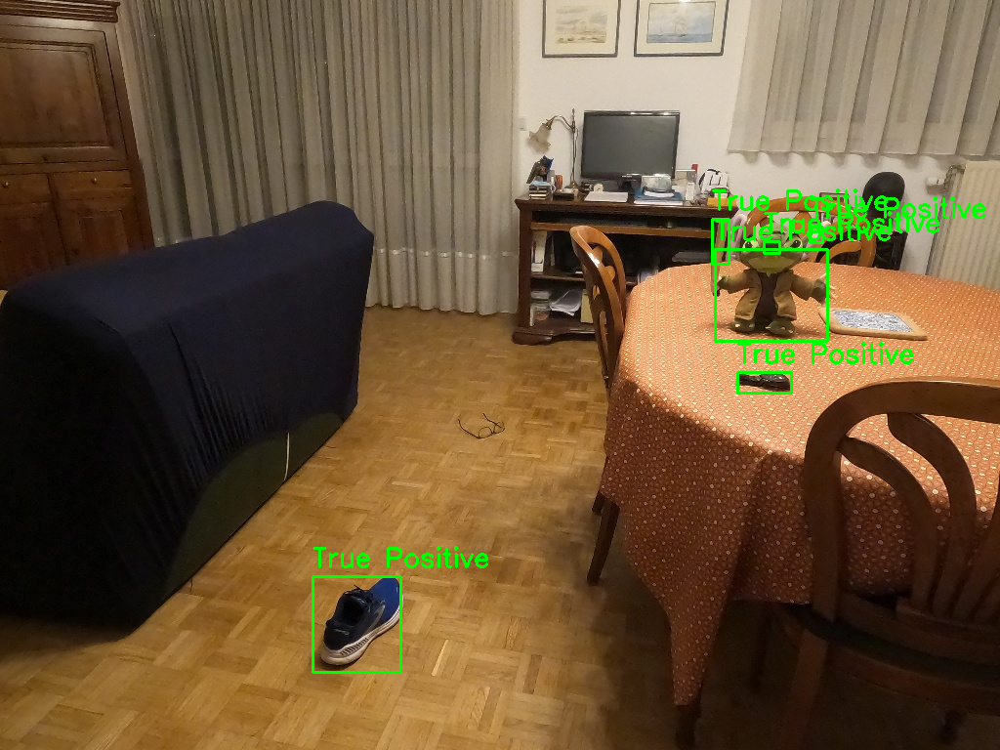

False Positives: 0
False Negatives: 1
True Positives: 6
Accuracy: 0.8571428571428571
Precision: 1.0
Recall: 0.8571428571428571
F1 Score: 0.923076923076923


In [ ]:
reference_image = cv2.imread('/content/sample_data/Resized_Images/Background.JPG')
gopro02_image = cv2.imread('/content/sample_data/Resized_Images/GOPR001.JPG')

# Convertir les images en niveaux de gris
reference_gray = cv2.cvtColor(reference_image, cv2.COLOR_BGR2GRAY)
gopro02_gray = cv2.cvtColor(gopro02_image, cv2.COLOR_BGR2GRAY)

# Soustraction d'arrière-plan pour détecter les différences
diff = cv2.absdiff(reference_gray, gopro02_gray)

# Seuillage de l'image de différence pour obtenir un masque binaire
threshold = 30  # Ajuster cette valeur selon vos besoins
_, binary_mask = cv2.threshold(diff, threshold, 255, cv2.THRESH_BINARY)

# Suppression des faux positifs à l'aide de transformations morphologiques
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
opening = cv2.morphologyEx(binary_mask, cv2.MORPH_OPEN, kernel, iterations=2)

# Segmentation pour isoler chaque objet
contours, _ = cv2.findContours(opening, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Dessiner un rectangle autour de chaque objet détecté
objects_with_boxes = gopro02_image.copy()
false_positives = 0
true_positives = 0
false_negatives = 0

for contour in contours:
    if cv2.contourArea(contour) > 100:  # Ajuster cette valeur selon vos besoins
        x, y, w, h = cv2.boundingRect(contour)
        cv2.rectangle(objects_with_boxes, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # Vérifier s'il y a chevauchement avec l'image de référence
        if np.any(diff[y:y + h, x:x + w] != 0):
            cv2.putText(objects_with_boxes, 'True Positive', (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)
            true_positives += 1
        else:
            cv2.putText(objects_with_boxes, 'False Positive', (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 0, 255), 2)
            false_positives += 1
    else:
        false_negatives += 1

display_image(objects_with_boxes)


total_objects = true_positives + false_negatives
accuracy = true_positives / total_objects
precision = true_positives / (true_positives + false_positives)
recall = true_positives / (true_positives + false_negatives)
f1_score = 2 * (precision * recall) / (precision + recall)

print("False Positives:", false_positives)
print("False Negatives:", false_negatives)
print("True Positives:", true_positives)
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1_score)